# M5 UNSUPERVISED LEARNING with ML AI (DIMENSION REDUCTION AND CLUSTERING)

<img src="https://www.thewrap.com/wp-content/uploads/2014/06/Walmart-logo.jpg" width="500" height="300" />




- We are tasked with forecasting hierarchical sales data from Wal-Mart.
- The data, covers stores in three US States (California, Texas, and Wisconsin) and includes item level, department, product categories, and store details.
- In addition, it has explanatory variables such as price, promotions, day of the week, and special events.
- We will first visualize the data and perform dimension reduction and clustering with unsupervised learning algorithms.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
from itertools import cycle
plt.style.use('bmh')
color_cycle = cycle(plt.rcParams['axes.prop_cycle'].by_key()['color'])

# Data Files
- `calendar.csv` - Contains information about the dates on which the products are sold.
- `sales_train_validation.csv` - Contains the historical daily unit sales data per product and store [d_1 - d_1913]
- `sample_submission.csv` - The correct format for submissions. Reference the Evaluation tab for more info.
- `sell_prices.csv` - Contains information about the price of the products sold per store and date.

Not available yet:
- `sales_train_evaluation.csv` - Available one month before competition deadline. Will include sales [d_1 - d_1941]

In [3]:
# Read in the data
cal = pd.read_csv('calendar.csv')
stv = pd.read_csv('sales_train_validation.csv')
ss = pd.read_csv('sample_submission.csv')
sellp = pd.read_csv('sell_prices.csv')

### UNSUPERVISED LEARNING CAPSTONE PROJECT

In [24]:
## imports
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn import metrics
from sklearn.cluster import KMeans, MiniBatchKMeans, AgglomerativeClustering, DBSCAN
from sklearn.mixture import GaussianMixture
import umap
import pandas as pd
import numpy as np
import seaborn as sns
import hvplot.pandas
import holoviews as hv

In [25]:
stv.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,HOBBIES_1_001_CA_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,1,3,0,1,1,1,3,0,1,1
1,HOBBIES_1_002_CA_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,HOBBIES_1_003_CA_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,2,1,2,1,1,1,0,1,1,1
3,HOBBIES_1_004_CA_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,1,0,5,4,1,0,1,3,7,2
4,HOBBIES_1_005_CA_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,2,1,1,0,1,1,2,2,2,4


In [26]:
sellp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6841121 entries, 0 to 6841120
Data columns (total 5 columns):
store_id      object
item_id       object
wm_yr_wk      int64
sell_price    float64
Category      object
dtypes: float64(1), int64(1), object(3)
memory usage: 261.0+ MB


In [28]:
stv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30490 entries, 0 to 30489
Columns: 1919 entries, id to d_1913
dtypes: int64(1913), object(6)
memory usage: 446.4+ MB


**There are 7 categorical columns and 1913 numerical columns that contains the historical sales of walmart.**

* Let's keep "cat_id", "store_id", "state_id" and drop the remaining categorical columns. These two columns are good enough to explain their types and store locations.

In [29]:
stv.drop(columns= ['id','dept_id'], inplace=True, axis=1)

Let's find which cluster of sales had the most number of sales with comparison to others. 
Which store, category, and state had higher sales through unsupervised learning algorithms.

In [30]:
from sklearn.preprocessing import LabelEncoder
LE = LabelEncoder()
LE_cat_id = LabelEncoder()
LE_store_id = LabelEncoder()
LE_state_id = LabelEncoder()
LE_item_id = LabelEncoder()
stv['cat_id'] = LE_cat_id.fit_transform(stv['cat_id'])
stv['store_id'] = LE_store_id.fit_transform(stv['store_id'])
stv['state_id'] = LE_state_id.fit_transform(stv['state_id'])
stv['item_id'] = LE_state_id.fit_transform(stv['item_id'])

In [31]:
stv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30490 entries, 0 to 30489
Columns: 1917 entries, item_id to d_1913
dtypes: int64(1917)
memory usage: 445.9 MB


## Dimensionality Reduction

In [32]:
X = stv.iloc[:,:]

## PCA Reduction method

In [33]:
scaler = StandardScaler()
X_std = StandardScaler().fit_transform(X)
pca = PCA().fit(X_std)

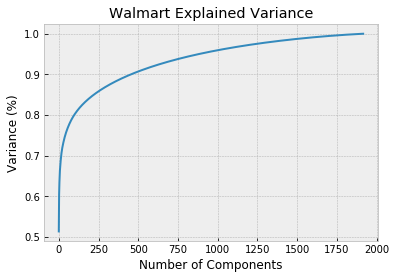

In [34]:
#Plotting the Cumulative Summation of the Explained Variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Walmart Explained Variance')
plt.show()

**1300 components would be an ideal number to retain atleast 97% variance assoicated with the stv dataset.**

In [35]:
pca = PCA(n_components=1250)

# We get the components by 
# calling fit_transform method with our data
pca_components = pca.fit_transform(X_std)

In [36]:
pca_components_stv = pd.DataFrame(pca_components)

In [37]:
pca_components_stv.head()

,0,1,2,3,4,5,6,7,8,9,...,1240,1241,1242,1243,1244,1245,1246,1247,1248,1249
0,-9.295160,1.727254,-0.251899,-0.739727,0.352416,-0.008696,0.746960,-0.582662,-0.178913,-0.453960,...,0.121204,0.018593,0.238273,0.045096,-0.101305,0.034403,-0.320940,-0.083543,0.006643,-0.081851
1,-10.128819,-0.534053,1.337545,-0.004757,-0.067922,-0.092219,0.313446,0.539947,1.063052,-0.656950,...,-0.037888,-0.000718,0.069650,0.303684,-0.124457,0.088596,-0.028628,0.338446,0.040451,-0.038162
2,-11.293725,0.275893,0.341378,-0.779342,-0.406771,0.349882,0.137884,-0.111971,0.281442,-0.149865,...,-0.004338,0.066831,-0.040692,-0.054581,-0.072687,0.200800,0.038300,0.020086,-0.207547,-0.111301
3,6.658472,2.501173,-3.168487,-0.438715,1.979863,-0.574279,2.939920,0.341929,2.735688,-0.555845,...,0.112985,0.026481,-0.115172,-0.222715,-0.730486,-0.114638,0.280109,-0.022265,0.634800,-0.138068
4,-1.939302,0.020924,0.343232,-0.793871,-0.830808,-0.889682,-0.318068,0.848602,2.088655,-0.798911,...,-0.166833,-0.475421,-0.581603,-0.070487,0.104757,-0.690333,-0.087438,0.489506,0.365009,0.332221


In [38]:
pca_components_stv['cat_id'] = LE_cat_id.inverse_transform(stv['cat_id'])
pca_components_stv['store_id'] = LE_store_id.inverse_transform(stv['store_id'])
pca_components_stv['state_id'] = LE_state_id.inverse_transform(stv['state_id'])

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
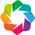

:NdOverlay   [cat_id]
   :Scatter   [0]   (1)

<Figure size 864x288 with 0 Axes>

In [39]:
hv.extension('bokeh')

plt.figure(figsize=(12,4)) 
pca_components_stv.hvplot(kind='scatter', x='0', y='1', by='cat_id')

In [40]:
pca_components_stv.hvplot(kind='scatter', x='0', y='1', by='state_id')

:NdOverlay   [state_id]
   :Scatter   [0]   (1)

Texas has most hobbies related, WI had more household related and CA had More food related

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
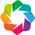

:NdOverlay   [store_id]
   :Scatter   [0]   (1)

In [41]:
hv.extension('bokeh') #For colab notebook purpose

pca_components_stv.hvplot(kind='scatter', x='0', y='1', by='store_id')

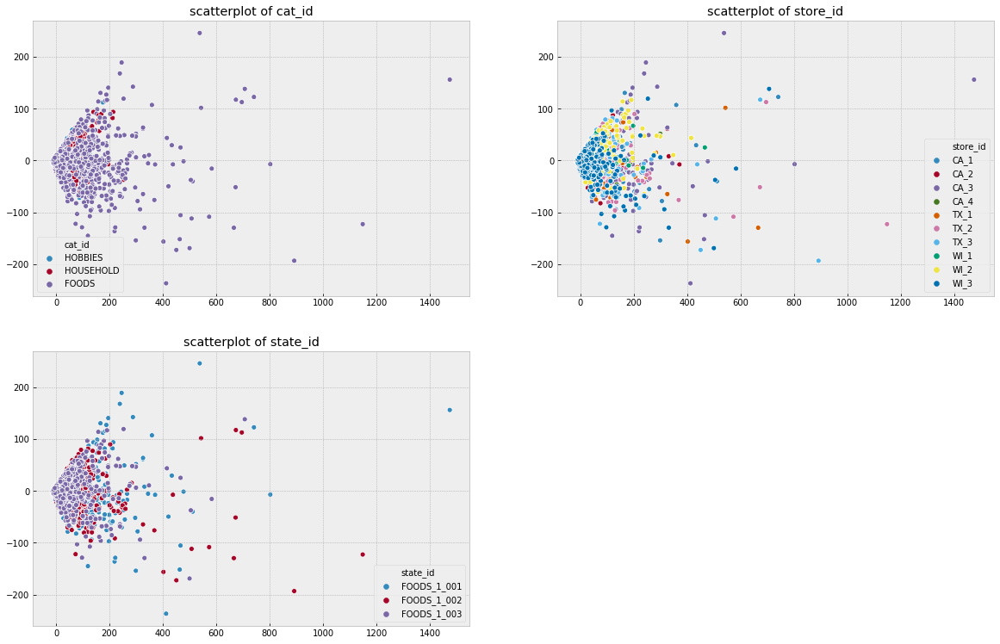

In [42]:
plt.figure(figsize = (20,20))

List = ['cat_id','store_id','state_id']

for i, col in enumerate (List):
    plt.subplot(len(List),2,i+1)
    sns.scatterplot(pca_components[:, 0], pca_components[:, 1], hue=pca_components_stv[col])
    plt.title("scatterplot of {}".format(col))
    
plt.show()

In [43]:
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [5.13973346e-01 4.91358426e-02 4.16107277e-02 ... 4.87663044e-05
 4.86297943e-05 4.84920679e-05]


PCA seems to plot a lot of noise in the data

## Multi-Component Analysis

## t-SNE Reduction method

**t-SNE Reduction method is not recommended for datasets with high dimensionality.**

In [44]:
tsne = TSNE(n_components=3, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_std)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 30490 samples in 6.767s...
[t-SNE] Computed neighbors for 30490 samples in 11337.158s...
[t-SNE] Computed conditional probabilities for sample 1000 / 30490
[t-SNE] Computed conditional probabilities for sample 2000 / 30490
[t-SNE] Computed conditional probabilities for sample 3000 / 30490
[t-SNE] Computed conditional probabilities for sample 4000 / 30490
[t-SNE] Computed conditional probabilities for sample 5000 / 30490
[t-SNE] Computed conditional probabilities for sample 6000 / 30490
[t-SNE] Computed conditional probabilities for sample 7000 / 30490
[t-SNE] Computed conditional probabilities for sample 8000 / 30490
[t-SNE] Computed conditional probabilities for sample 9000 / 30490
[t-SNE] Computed conditional probabilities for sample 10000 / 30490
[t-SNE] Computed conditional probabilities for sample 11000 / 30490
[t-SNE] Computed conditional probabilities for sample 12000 / 30490
[t-SNE] Computed conditional probabilities fo

In [45]:
tsne_results_stv = pd.DataFrame(tsne_results)

tsne_results_stv['cat_id'] = LE_cat_id.inverse_transform(stv['cat_id'])
tsne_results_stv['store_id'] = LE_store_id.inverse_transform(stv['store_id'])
tsne_results_stv['state_id'] = LE_store_id.inverse_transform(stv['state_id'])

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
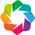

:NdOverlay   [cat_id]
   :Scatter   [0]   (1)

In [46]:
hv.extension('bokeh') 
tsne_results_stv.hvplot(kind='scatter', x='0', y='1', by='cat_id')

In [47]:
tsne_results_stv.hvplot(kind='scatter', x='0', y='1', by='store_id')

:NdOverlay   [store_id]
   :Scatter   [0]   (1)

In [48]:
tsne_results_stv.hvplot(kind='scatter', x='0', y='1', by='state_id')

:NdOverlay   [state_id]
   :Scatter   [0]   (1)

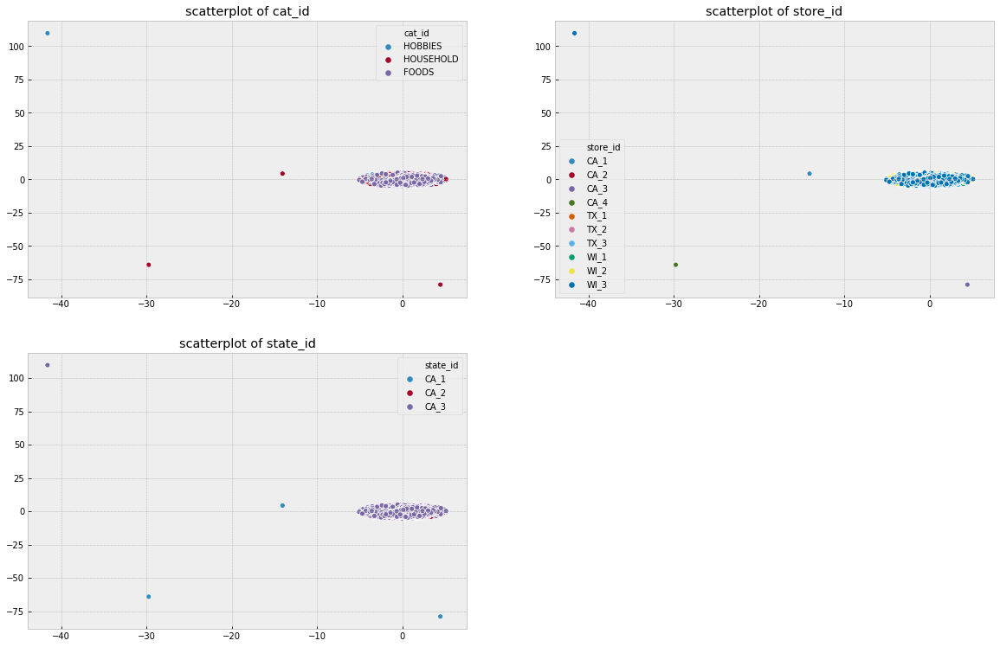

In [49]:
plt.figure(figsize = (20,20))

List = ['cat_id','store_id','state_id']

for i, col in enumerate (List):
    plt.subplot(len(List),2,i+1)
    sns.scatterplot(tsne_results[:, 0], tsne_results[:, 1], hue=tsne_results_stv[col])
    plt.title("scatterplot of {}".format(col))
    
plt.show()

## UMAP Reduction Method

In [50]:
## Let's fit transform X again as we are working with UMAP reduction
X_std = StandardScaler().fit_transform(X)

In [51]:
umap_results = umap.UMAP(n_neighbors=15,
                      min_dist=0.3, 
                      metric='correlation').fit_transform(X)

/Users/sajithgowthaman/opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../opt/anaconda3/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba.njit(parallel=True)
def build_candidates(current_graph, n_vertices, n_neighbors, max_candidates, rng_state):
^

  current_graph, n_vertices, n_neighbors, max_candidates, rng_state
/Users/sajithgowthaman/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

Fi

In [52]:
umap_results_stv = pd.DataFrame(umap_results)

umap_results_stv['cat_id'] = LE_cat_id.inverse_transform(stv['cat_id'])
umap_results_stv['store_id'] = LE_store_id.inverse_transform(stv['store_id'])
umap_results_stv['state_id'] = LE_store_id.inverse_transform(stv['state_id'])

In [53]:
umap_results_stv.hvplot(kind='scatter', x='0', y='1', by='cat_id')

:NdOverlay   [cat_id]
   :Scatter   [0]   (1)

In [54]:
umap_results_stv.hvplot(kind='scatter', x='0', y='1', by='store_id')

:NdOverlay   [store_id]
   :Scatter   [0]   (1)

In [55]:
umap_results_stv.hvplot(kind='scatter', x='0', y='1', by='state_id')

:NdOverlay   [state_id]
   :Scatter   [0]   (1)

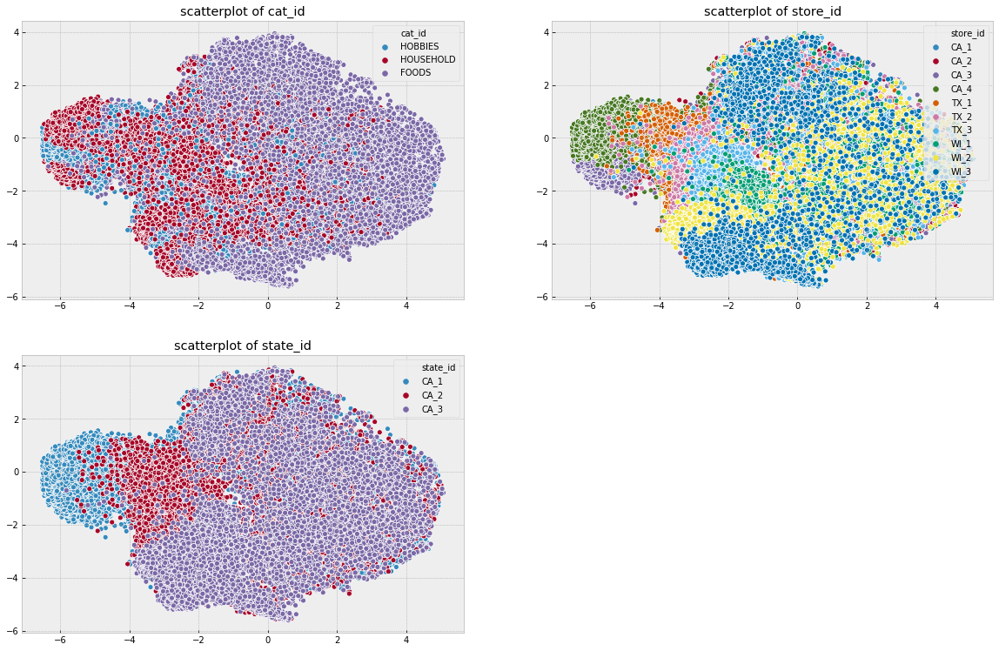

In [56]:
plt.figure(figsize = (20,20))

List = ['cat_id','store_id','state_id']

for i, col in enumerate (List):
    plt.subplot(len(List),2,i+1)
    sns.scatterplot(umap_results[:, 0], umap_results[:, 1], hue=umap_results_stv[col])
    plt.title("scatterplot of {}".format(col))
    
plt.show()

In [57]:
umap_results_stv

,0,1,cat_id,store_id,state_id
0,-4.445959,-0.971134,HOBBIES,CA_1,CA_1
1,-5.033252,0.905968,HOBBIES,CA_1,CA_1
2,-4.591636,-0.691188,HOBBIES,CA_1,CA_1
3,1.342995,-1.684722,HOBBIES,CA_1,CA_1
4,-3.496430,-1.247230,HOBBIES,CA_1,CA_1
...,...,...,...,...,...
30485,-1.964288,2.155511,FOODS,WI_3,CA_3
30486,-1.948140,-4.260460,FOODS,WI_3,CA_3
30487,-1.460704,1.974504,FOODS,WI_3,CA_3
30488,0.379134,-3.938910,FOODS,WI_3,CA_3


## Clustering

## K-means clustering

In [58]:
Sum_of_squared_distances = []
K = range(1,15)
for k in K:
    kmeans = KMeans(n_clusters=k)
    kmeans = kmeans.fit(X_std)
    Sum_of_squared_distances.append(kmeans.inertia_)

**Let's Choose the number of clusters from the elbow method.**

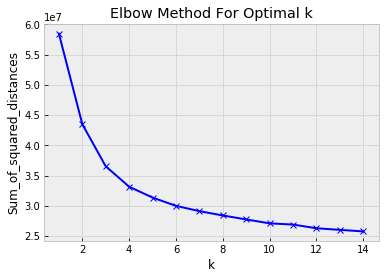

In [59]:
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

### choosing number of cluster as 4 would be a good option as that is where the curve is starting bend.

In [60]:
# Defining the k-means
kmeans_cluster = KMeans(n_clusters=4, random_state=123)

# Fit model
%timeit kmeans_cluster.fit(X_std)
y_pred = kmeans_cluster.predict(X_std)

46.7 s ± 30.3 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


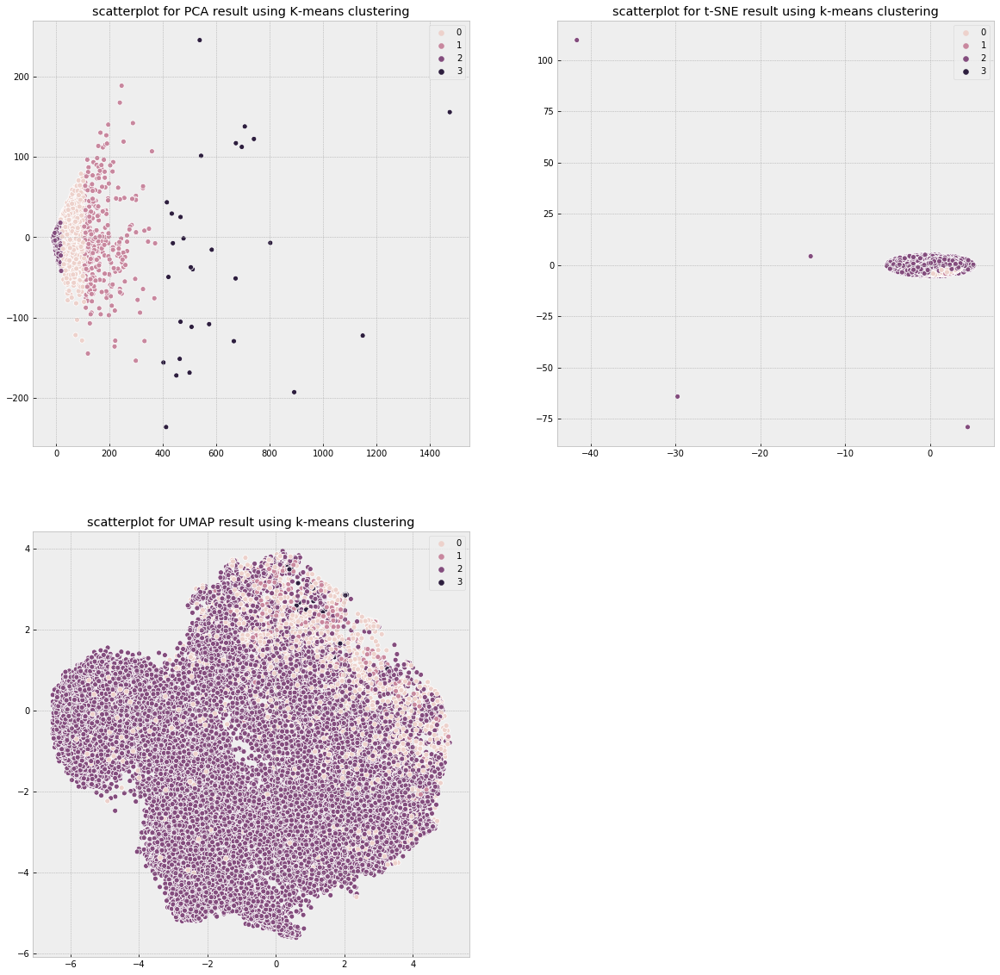

In [61]:
plt.figure(figsize = (20,20))

plt.subplot(2,2,1)
sns.scatterplot(pca_components[:, 0], pca_components[:, 1], hue=y_pred)
plt.title("scatterplot for PCA result using K-means clustering")

plt.subplot(2,2,2)
sns.scatterplot(tsne_results[:, 0], tsne_results[:, 1], hue=y_pred)
plt.title("scatterplot for t-SNE result using k-means clustering")

plt.subplot(2,2,3)
sns.scatterplot(umap_results[:, 0], umap_results[:, 1], hue=y_pred)
plt.title("scatterplot for UMAP result using k-means clustering")

plt.show()

In [62]:
labels = KMeans(n_clusters=4, random_state=123).fit_predict(X_std)
print(metrics.silhouette_score(X_std, labels, metric='euclidean'))

0.66350284427346


**Let's try minibatch k-means**

In [63]:
# Defining the mini-batch k-means
minikmeans_cluster = MiniBatchKMeans(
    init='random',
    n_clusters=4,
    batch_size=50)

# Fit model
%timeit minikmeans_cluster.fit(X_std)
minikmeans_cluster = minikmeans_cluster.predict(X_std)

1.1 s ± 60.7 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


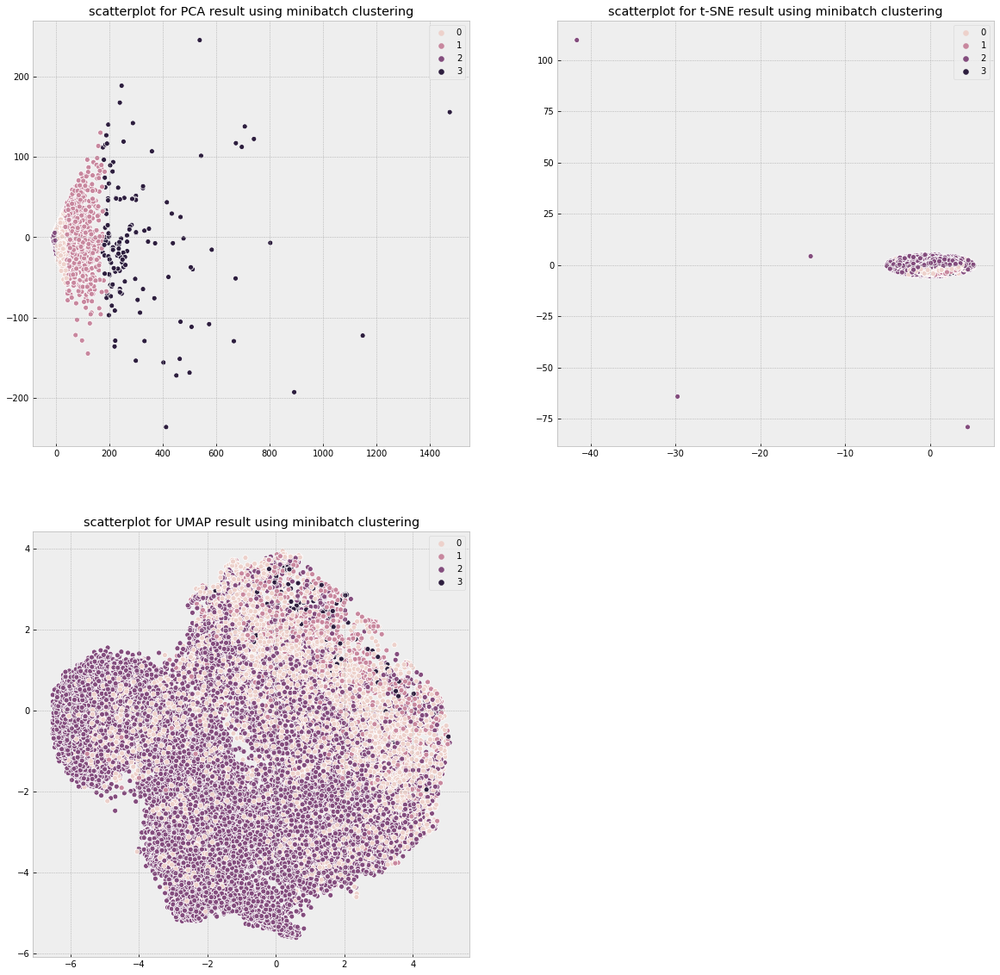

In [64]:
plt.figure(figsize = (20,20))

plt.subplot(2,2,1)
sns.scatterplot(pca_components[:, 0], pca_components[:, 1], hue=minikmeans_cluster)
plt.title("scatterplot for PCA result using minibatch clustering")

plt.subplot(2,2,2)
sns.scatterplot(tsne_results[:, 0], tsne_results[:, 1], hue=minikmeans_cluster)
plt.title("scatterplot for t-SNE result using minibatch clustering")

plt.subplot(2,2,3)
sns.scatterplot(umap_results[:, 0], umap_results[:, 1], hue=minikmeans_cluster)
plt.title("scatterplot for UMAP result using minibatch clustering")

plt.show()

In [65]:
labels = MiniBatchKMeans(n_clusters=3, random_state=123).fit_predict(X_std)
print(metrics.silhouette_score(X_std, labels, metric='euclidean'))

0.6840402243756504


## Heirarchical agglomerative clustering

In [66]:
from scipy.cluster.hierarchy import dendrogram, linkage
# Defining the agglomerative clustering
agg_cluster = AgglomerativeClustering(linkage='complete', 
                                      affinity='cosine',
                                      n_clusters=5)

# Fit model
clusters = agg_cluster.fit_predict(X_std)

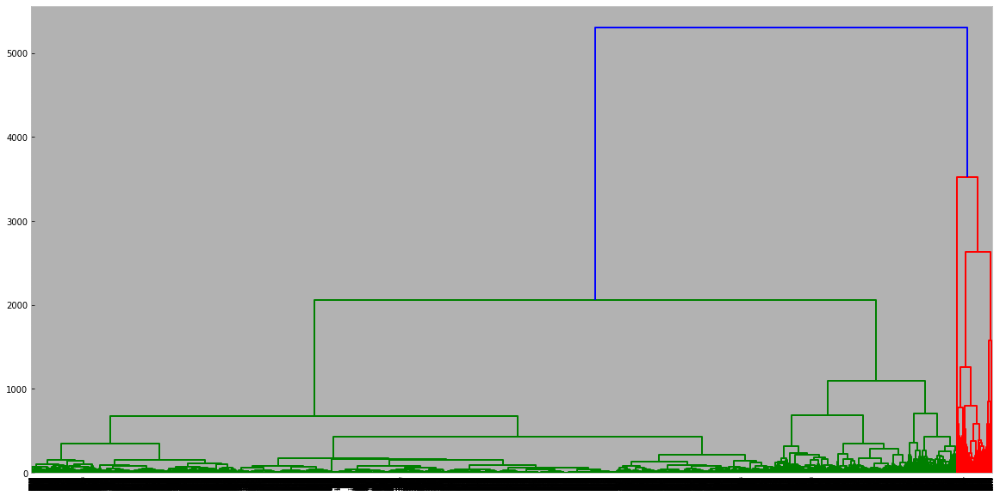

In [67]:
plt.figure(figsize=(20,10))
dendrogram(linkage(X_std, method='ward'))
plt.show()

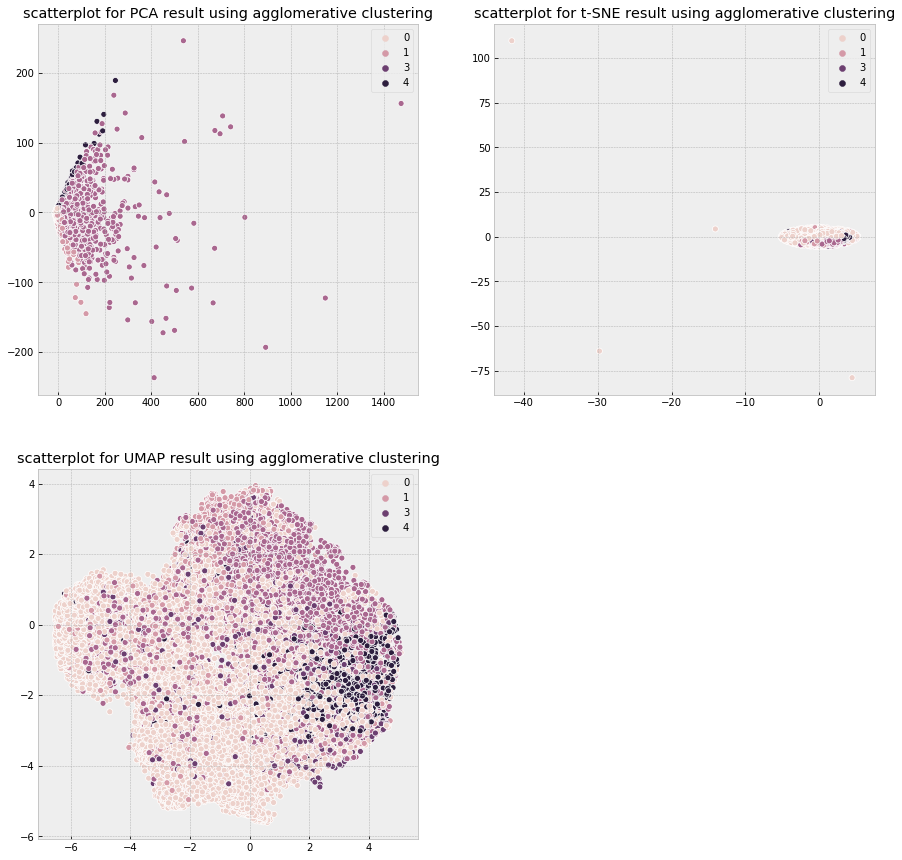

In [68]:
plt.figure(figsize = (15,15))

plt.subplot(2,2,1)
sns.scatterplot(pca_components[:, 0], pca_components[:, 1], hue=clusters)
plt.title("scatterplot for PCA result using agglomerative clustering")

plt.subplot(2,2,2)
sns.scatterplot(tsne_results[:, 0], tsne_results[:, 1], hue=clusters)
plt.title("scatterplot for t-SNE result using agglomerative clustering")

plt.subplot(2,2,3)
sns.scatterplot(umap_results[:, 0], umap_results[:, 1], hue=clusters)
plt.title("scatterplot for UMAP result using agglomerative clustering")

plt.show()

## DBSCAN Clustering

In [69]:
# Defining the agglomerative clustering
dbscan_cluster = DBSCAN(eps=3, min_samples=5)

# Fit model
clusters = dbscan_cluster.fit_predict(X_std)

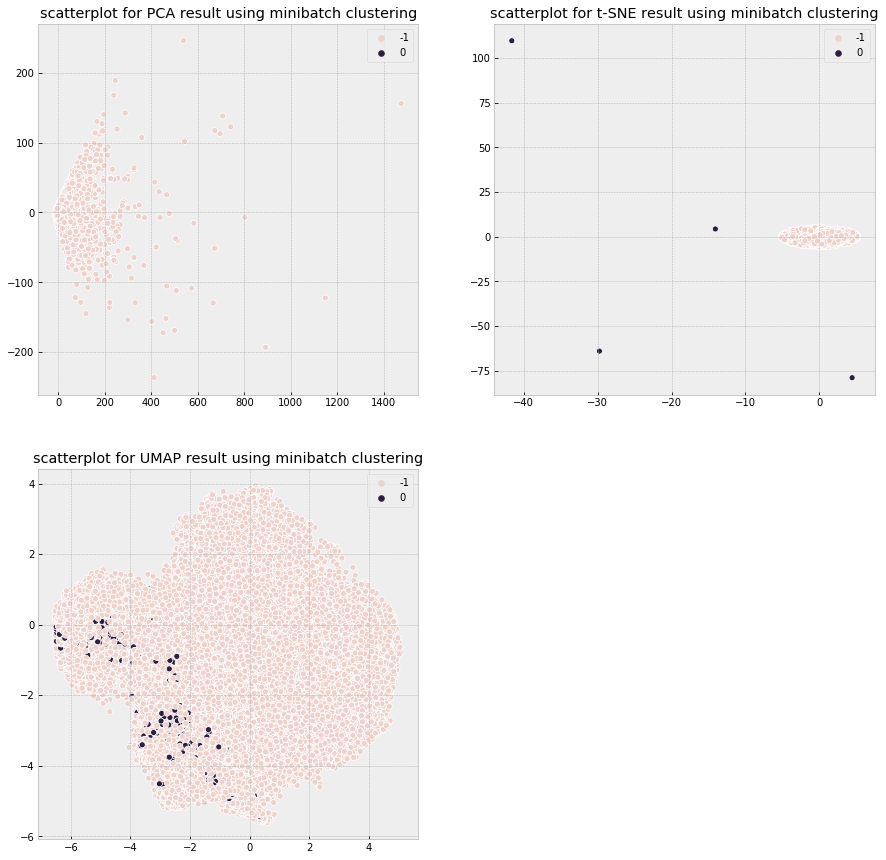

In [70]:
plt.figure(figsize = (15,15))

plt.subplot(2,2,1)
sns.scatterplot(pca_components[:, 0], pca_components[:, 1], hue=clusters)
plt.title("scatterplot for PCA result using minibatch clustering")

plt.subplot(2,2,2)
sns.scatterplot(tsne_results[:, 0], tsne_results[:, 1], hue=clusters)
plt.title("scatterplot for t-SNE result using minibatch clustering")

plt.subplot(2,2,3)
sns.scatterplot(umap_results[:, 0], umap_results[:, 1], hue=clusters)
plt.title("scatterplot for UMAP result using minibatch clustering")

plt.show()

In [71]:
print("The silhouette score of the DBSCAN solution: {}"
      .format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

The silhouette score of the DBSCAN solution: -0.4435569847345192


## Gaussian Mixture Model Clustering 

In [72]:
# Defining the agglomerative clustering
gmm_cluster = GaussianMixture(n_components=15, random_state=123)

# Fit model
clusters = gmm_cluster.fit_predict(X_std)

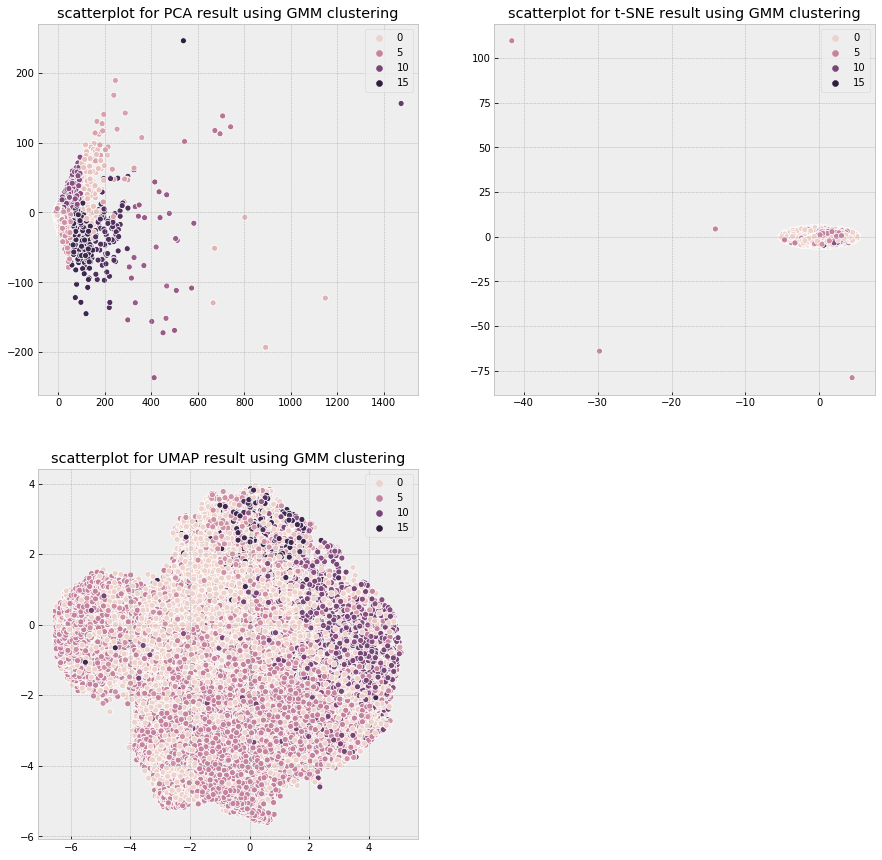

In [73]:
plt.figure(figsize = (15,15))

plt.subplot(2,2,1)
sns.scatterplot(pca_components[:, 0], pca_components[:, 1], hue=clusters)
plt.title("scatterplot for PCA result using GMM clustering")

plt.subplot(2,2,2)
sns.scatterplot(tsne_results[:, 0], tsne_results[:, 1], hue=clusters)
plt.title("scatterplot for t-SNE result using GMM clustering")

plt.subplot(2,2,3)
sns.scatterplot(umap_results[:, 0], umap_results[:, 1], hue=clusters)
plt.title("scatterplot for UMAP result using GMM clustering")

plt.show()

In [74]:
print("The silhouette score of the DBSCAN solution: {}"
      .format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

The silhouette score of the DBSCAN solution: 0.16554267472007486


**The highest Silhoutte score is given by Minibatch k-means. That is a pretty good score.**

### Forecasting Sale Price with FBPROPHET

In [77]:
#Let's Merge the data using Sqlite. 
#Run it only once.
#cal.to_sql('calender', 'sqlite:///this_is_actually_a_database.db')

In [78]:
merged = pd.read_sql_query(
    """
    SELECT sellp.*,
           cal.date
    FROM sell_prices AS sellp, calender AS cal
    ON sellp.wm_yr_wk = cal.wm_yr_wk
    LIMIT 100000
    """,
    'sqlite:///this_is_actually_a_database.db'
)

In [79]:
merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 6 columns):
index         100000 non-null int64
store_id      100000 non-null object
item_id       100000 non-null object
wm_yr_wk      100000 non-null int64
sell_price    100000 non-null float64
date          100000 non-null object
dtypes: float64(1), int64(2), object(3)
memory usage: 4.6+ MB


In [80]:
merged.head()

,index,store_id,item_id,wm_yr_wk,sell_price,date
0,0,CA_1,HOBBIES_1_001,11325,9.58,2013-07-13
1,0,CA_1,HOBBIES_1_001,11325,9.58,2013-07-14
2,0,CA_1,HOBBIES_1_001,11325,9.58,2013-07-15
3,0,CA_1,HOBBIES_1_001,11325,9.58,2013-07-16
4,0,CA_1,HOBBIES_1_001,11325,9.58,2013-07-17


In [81]:
merged['date'] =  pd.to_datetime(merged['date'])

In [82]:
#Let's take the year 2013 to predict 2014
new_df = merged[(merged.date >= '2013-01-01 00:00:00') & (merged.date < '2014-01-01 00:00:00')]
new_df = new_df.reset_index(drop=True)

In [83]:
from sklearn.preprocessing import LabelEncoder

LE = LabelEncoder()
LE_store_id = LabelEncoder()
LE_item_id = LabelEncoder()
new_df['store_id'] = LE_store_id.fit_transform(new_df['store_id'])
new_df['item_id'] = LE_item_id.fit_transform(new_df['item_id'])

In [84]:
X= new_df.drop(columns='sell_price', axis= 1)
y= new_df.sell_price

In [85]:
train_dataset= pd.DataFrame()
train_dataset['ds'] = pd.to_datetime(X["date"])
train_dataset['y']=y
train_dataset.head(2)

,ds,y
0,2013-07-13,9.58
1,2013-07-14,9.58


In [86]:
from fbprophet import Prophet
from fbprophet.plot import plot_plotly

prophet = Prophet()
prophet.fit(train_dataset)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/sajithgowthaman/opt/anaconda3/lib/python3.7/site-packages/pystan/misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [87]:
future = prophet.make_future_dataframe(periods=24, freq='M')
future.tail(2)

,ds
19384,2015-11-30
19385,2015-12-31


In [88]:
forecast=prophet.predict(future)

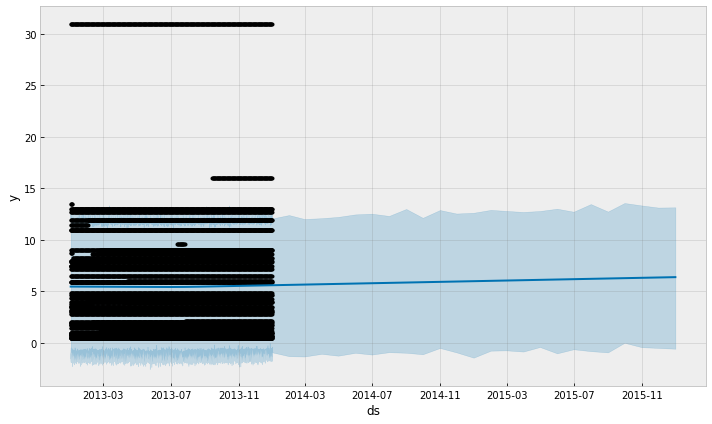

In [89]:
fig1 =prophet.plot(forecast)

### Trend and Seasonality

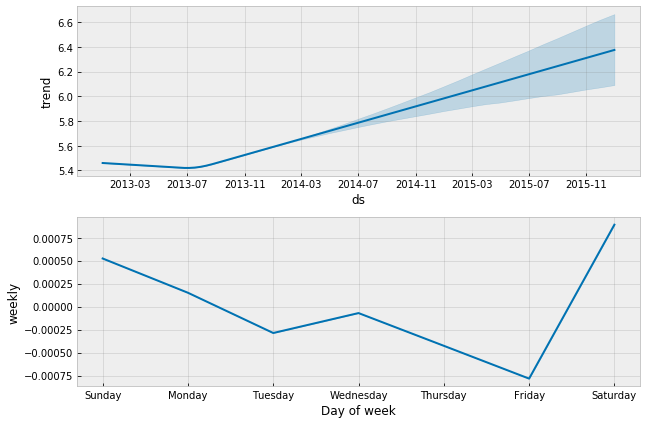

In [90]:
fig1 = prophet.plot_components(forecast)

### Change points: To find where the data points had abrupt changes:

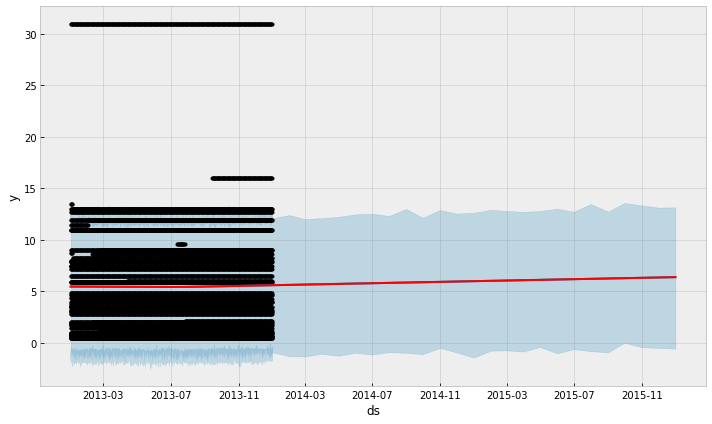

In [91]:
from fbprophet.plot import add_changepoints_to_plot
fig = prophet.plot(forecast)
a = add_changepoints_to_plot(fig.gca(), prophet, forecast)

In [92]:
prophet.changepoints

620     2013-01-13
1239    2013-01-26
1859    2013-02-07
2478    2013-02-20
3098    2013-03-05
3717    2013-03-17
4337    2013-03-29
4956    2013-04-11
5576    2013-04-23
6195    2013-05-04
6815    2013-05-16
7434    2013-05-28
8054    2013-06-09
8673    2013-06-21
9293    2013-07-02
9912    2013-07-14
10532   2013-07-26
11151   2013-08-06
11771   2013-08-17
12390   2013-08-29
13010   2013-09-09
13629   2013-09-20
14249   2013-10-01
14868   2013-10-12
15488   2013-10-23
Name: ds, dtype: datetime64[ns]

### Summary
* We were able to reduce the data from 1913 columns to 1250 using PCA, 3 using Tsne and Umap.
* The data was plotted using Hvplot's Bokeh for dynamic visualization purpose.
* The data was clustered using unsupervised learning's clustering algorithms such as K-means, DBSCAN, GMM and Heirarchical agglomerative clustering (Linkage mechanism).
* The highest silhoutte score was achieved by MiniBatch K-Means with 68% Accuracy.
* The sale price was merged to the calender for the year 2014 and forecasted with Facebook Prophet's forecasting model.
